## Project_5_Booking reviews

In [108]:
import pandas as pd
import numpy as np

from scipy import stats
import statsmodels.api as sm
from statsmodels import stats as sms

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import category_encoders as ce # импорт для работы с кодировщиком # import for working with the encoder
import nltk 
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer # оценка слов на позитивное или негативое настроение
# rating words for positive or negative sentiment

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/macbookpro/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


### 1. Исследование данных. Data Exploration  

In [109]:
hotels = pd.read_csv('hotels.csv')
hotels.head()

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,tags,days_since_review,lat,lng
0,Stratton Street Mayfair Westminster Borough Lo...,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,4,7,10.0,"[' Leisure trip ', ' Couple ', ' Studio Suite ...",531 day,51.507894,-0.143671
1,130 134 Southampton Row Camden London WC1B 5AF...,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,2,14,6.3,"[' Business trip ', ' Couple ', ' Standard Dou...",203 day,51.521009,-0.123097
2,151 bis Rue de Rennes 6th arr 75006 Paris France,32,10/18/2016,8.9,Legend Saint Germain by Elegancia,China,No kettle in room,6,406,No Positive,0,14,7.5,"[' Leisure trip ', ' Solo traveler ', ' Modern...",289 day,48.845377,2.325643
3,216 Avenue Jean Jaures 19th arr 75019 Paris Fr...,34,9/22/2015,7.5,Mercure Paris 19 Philharmonie La Villette,United Kingdom,No Negative,0,607,Friendly staff quiet comfortable room spotles...,11,8,10.0,"[' Leisure trip ', ' Solo traveler ', ' Standa...",681 day,48.888697,2.394540
4,Molenwerf 1 1014 AG Amsterdam Netherlands,914,3/5/2016,8.5,Golden Tulip Amsterdam West,Poland,Torn sheets,4,7586,The staff was very friendly and helpful Break...,20,10,9.6,"[' Business trip ', ' Couple ', ' Standard Dou...",516 day,52.385601,4.847060


### Смотрим на наши данные. Let's look at our data

- hotel_address - адрес отеля (hotel address)

- review_date - дата, когда рецензент разместил соответствующий отзыв (the date the reviewer posted the relevant review)

- average_score - средний балл отеля, рассчитанный на основе последнего комментария за последний год (the average hotel rating calculated based on the latest comment over the past year)

- hotel_name - название отеля (hotel name)

- reviewer_nationality - национальность рецензента (reviewer nationality)

- negative_review - отрицательный отзыв, который рецензент дал отелю (a negative review the reviewer gave to the hotel)

- review_total_negative_word_counts - общее количество слов в отрицательном отзыв (review total negative word counts)

- positive_review - положительный отзыв, который рецензент дал отелю (a positive review the reviewer gave to the hotel)

- review_total_positive_word_counts - общее количество слов в положительном отзыве (review total positive word counts)

- reviewer_score - оценка, которую рецензент поставил отелю на основе своего опыта (the rating the reviewer gave the hotel based on their experience)

- total_number_of_reviews_reviewer_has_given - количество отзывов, которые рецензенты дали в прошлом (total number of reviews reviewer has given)

- total_number_of_reviews - общее количество действительных отзывов об отеле (total number of reviews)

- tags - теги, которые рецензент дал отелю (tags the reviewer gave the hotel)

- days_since_review - продолжительность между датой проверки и датой очистки (days since review)

- additional_number_of_scoring - есть также некоторые гости, которые просто поставили оценку сервису, а не оставили отзыв. Это число указывает, сколько там действительных оценок без проверки (There are also some guests who simply rated the service without leaving a review. This number indicates how many valid ratings there are without verification.)

- lat - широта отеля (hotel latitude)

- lng - долгота отеля (hotel longitude)

In [110]:
hotels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 17 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               386803 non-null  object 
 1   additional_number_of_scoring                386803 non-null  int64  
 2   review_date                                 386803 non-null  object 
 3   average_score                               386803 non-null  float64
 4   hotel_name                                  386803 non-null  object 
 5   reviewer_nationality                        386803 non-null  object 
 6   negative_review                             386803 non-null  object 
 7   review_total_negative_word_counts           386803 non-null  int64  
 8   total_number_of_reviews                     386803 non-null  int64  
 9   positive_review                             386803 non-null  object 
 

In [111]:
hotels.shape

(386803, 17)

In [112]:
hotels.nunique()

hotel_address                                   1493
additional_number_of_scoring                     480
review_date                                      731
average_score                                     34
hotel_name                                      1492
reviewer_nationality                             225
negative_review                               248828
review_total_negative_word_counts                402
total_number_of_reviews                         1142
positive_review                               311737
review_total_positive_word_counts                354
total_number_of_reviews_reviewer_has_given       194
reviewer_score                                    37
tags                                           47135
days_since_review                                731
lat                                             1472
lng                                             1472
dtype: int64

In [113]:
hotels.describe()

,additional_number_of_scoring,average_score,review_total_negative_word_counts,total_number_of_reviews,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,lat,lng
count,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000,386803.00000,386803.000000,384355.000000,384355.000000
mean,498.246536,8.397231,18.538988,2743.992042,17.776985,7.17725,8.396906,49.443522,2.823402
std,500.258012,0.547881,29.703369,2316.457018,21.726141,11.05442,1.636090,3.466936,4.579043
min,1.000000,5.200000,0.000000,43.000000,0.000000,1.00000,2.500000,41.328376,-0.369758
25%,169.000000,8.100000,2.000000,1161.000000,5.000000,1.00000,7.500000,48.214662,-0.143649
50%,342.000000,8.400000,9.000000,2134.000000,11.000000,3.00000,8.800000,51.499981,-0.000250
75%,660.000000,8.800000,23.000000,3613.000000,22.000000,8.00000,9.600000,51.516288,4.834443
max,2682.000000,9.800000,408.000000,16670.000000,395.000000,355.00000,10.000000,52.400181,16.429233


In [114]:
hotels.describe(include='object')

,hotel_address,review_date,hotel_name,reviewer_nationality,negative_review,positive_review,tags,days_since_review
count,386803,386803,386803,386803,386803,386803,386803,386803
unique,1493,731,1492,225,248828,311737,47135,731
top,163 Marsh Wall Docklands Tower Hamlets London ...,8/2/2017,Britannia International Hotel Canary Wharf,United Kingdom,No Negative,No Positive,"[' Leisure trip ', ' Couple ', ' Double Room '...",1 days
freq,3587,1911,3587,184033,95907,26885,3853,1911


In [115]:
# Проверим что видно в адресах отелей
# Let's check what's visible in hotel addresses 
hotels['hotel_address'].value_counts()

hotel_address
163 Marsh Wall Docklands Tower Hamlets London E14 9SJ United Kingdom              3587
372 Strand Westminster Borough London WC2R 0JJ United Kingdom                     3206
Westminster Bridge Road Lambeth London SE1 7UT United Kingdom                     3095
Scarsdale Place Kensington Kensington and Chelsea London W8 5SY United Kingdom    2688
7 Pepys Street City of London London EC3N 4AF United Kingdom                      2379
                                                                                  ... 
Via Palmanova 153 20132 Milan Italy                                                  7
40 Rue Rene Boulanger 10th arr 75010 Paris France                                    7
Via M Buonarroti 13 Fiera Milano City 20149 Milan Italy                              6
Johann Staud Stra e 32 16 Ottakring 1160 Vienna Austria                              6
13 Rue Fran ois Ory 92120 Paris France                                               5
Name: count, Length: 1493, dt

In [116]:
# Посчитаем сколько слов в негативных отзывах
# Let's count the number of words in negative reviews
len(hotels.at[0,'negative_review'].split())

1

In [117]:
len(hotels.at[2,'negative_review'].split())

4

Странно но значение в поле review_total_negative_word_counts не совпадает с реальностью.

It's strange, but the value in the review_total_negative_word_counts field does not match reality.

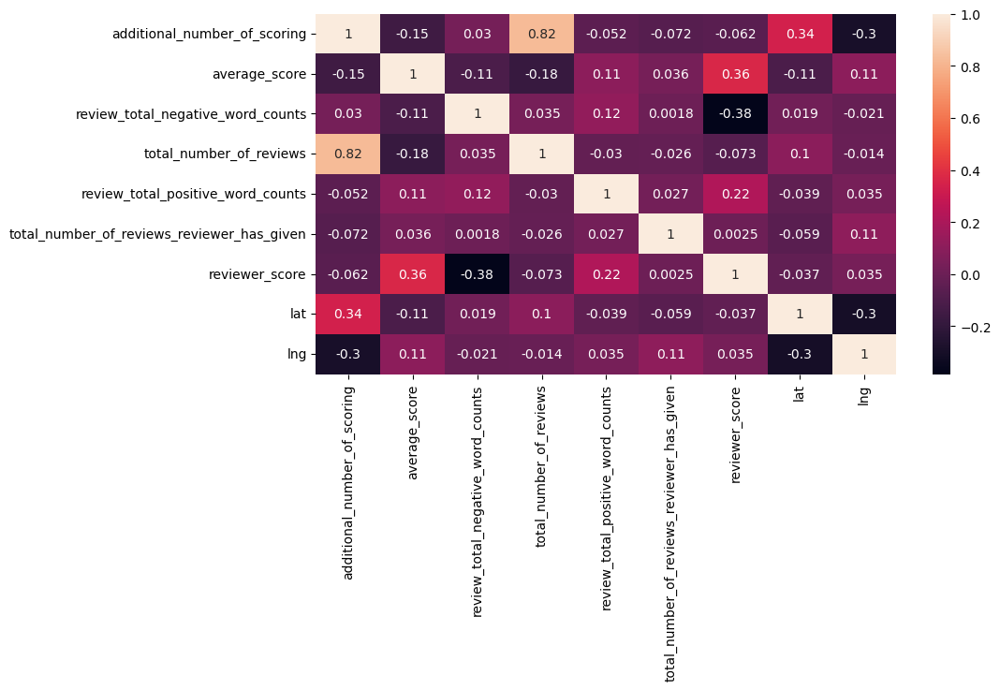

In [118]:
# Оцениваем мультиколинеарность и взаимосвязь с целевым признаком
# We evaluate multicolinearity and the relationship with the target feature
plt.figure(figsize = (10, 5))
sns.heatmap(hotels.corr(numeric_only=True), annot = True);

### 2. Подготовка данных. Data preparation

In [119]:
# заполняем пропуски медианой по каждому отелю
# fill in the blanks with the median for each hotel
hotels['lat'] = hotels['lat'].fillna(hotels['lat'].median())
hotels['lng'] = hotels['lng'].fillna(hotels['lng'].median())

In [120]:
hotels['lat'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 386803 entries, 0 to 386802
Series name: lat
Non-Null Count   Dtype  
--------------   -----  
386803 non-null  float64
dtypes: float64(1)
memory usage: 3.0 MB


In [121]:
hotels['lng'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 386803 entries, 0 to 386802
Series name: lng
Non-Null Count   Dtype  
--------------   -----  
386803 non-null  float64
dtypes: float64(1)
memory usage: 3.0 MB


In [122]:
hotels['hotel_name'].nunique()

1492

In [123]:
# Переводим дату в тип данных дата
# Converting a date to the datetime type
hotels['review_date'] = pd.to_datetime(hotels['review_date'])
display(hotels['review_date'])

0        2016-02-19
1        2017-01-12
2        2016-10-18
3        2015-09-22
4        2016-03-05
            ...    
386798   2017-04-19
386799   2017-02-13
386800   2016-02-07
386801   2017-05-21
386802   2016-08-05
Name: review_date, Length: 386803, dtype: datetime64[ns]

In [124]:
hotels['review_date'].sort_values().head(5)

143997   2015-08-04
86268    2015-08-04
159209   2015-08-04
217001   2015-08-04
28485    2015-08-04
Name: review_date, dtype: datetime64[ns]

In [125]:
hotels['review_date'].sort_values().tail(5)

167325   2017-08-03
372341   2017-08-03
54669    2017-08-03
321881   2017-08-03
315137   2017-08-03
Name: review_date, dtype: datetime64[ns]

### 3. Исследовательский анализ данных. Exploratory data analysis

In [126]:
import pycountry
# достаем из признака hotel_address страну и город
# We extract the country and city from the hotel_address attribute
# список всех стран (English names)
# list of all countries (English names)
countries = [c.name for c in pycountry.countries]

def extract_country(address):
    words = address.split()
    # пробуем 2 последних слова
    # let's try the last 2 words
    last_two = " ".join(words[-2:])
    if last_two in countries:
        return last_two
    # если не нашли, пробуем последнее
    # if we haven't found it, try the last one
    if words[-1] in countries:
        return words[-1]
    return None

valid_cities = ['London', 'Barcelona', 'Paris', 'Amsterdam', 'Vienna', 'Milan']

def fix_city(address):
    for city in valid_cities:
        if city in address:
            return city
    return None

hotels['hotel_city'] = hotels['hotel_address'].apply(fix_city)
hotels['hotel_country'] = hotels['hotel_address'].apply(extract_country)

In [127]:
hotels['hotel_city'].value_counts()

hotel_city
London       196774
Barcelona     45132
Paris         44830
Amsterdam     43006
Vienna        29178
Milan         27883
Name: count, dtype: int64

In [128]:
hotels['hotel_country'].value_counts()

hotel_country
United Kingdom    196774
Spain              45132
France             44830
Netherlands        43006
Austria            29178
Italy              27883
Name: count, dtype: int64

In [129]:
# проверяем, что данные по стране и городу идентичны
# we check that the data for the country and city are identical
hotels[['hotel_country', 'hotel_city']].value_counts()

hotel_country   hotel_city
United Kingdom  London        196774
Spain           Barcelona      45132
France          Paris          44830
Netherlands     Amsterdam      43006
Austria         Vienna         29178
Italy           Milan          27883
Name: count, dtype: int64

In [130]:
# кодируем признак города
# encode the city attribute
freq_city = hotels['hotel_city'].value_counts().to_dict()
hotels['city_freq'] = hotels['hotel_city'].map(freq_city)

In [131]:
# кодируем признак страны
# encode the country attribute
freq_country = hotels['hotel_country'].value_counts().to_dict()
hotels['country_freq'] = hotels['hotel_country'].map(freq_country)

In [132]:
# review_date → год, месяц, день
# review_date → year, month, day
hotels['review_year'] = pd.to_datetime(hotels['review_date']).dt.year
hotels['review_month'] = pd.to_datetime(hotels['review_date']).dt.month
hotels['review_day'] = pd.to_datetime(hotels['review_date']).dt.day

In [133]:
# reviewer_nationality → категориальный код
# reviewer_nationality → categorical code
hotels['reviewer_nationality_code'] = hotels['reviewer_nationality'].astype('category').cat.codes

In [134]:
# добавляем день недели как категориальный признак
# we add the day of the week as a categorical feature
hotels['review_weekday'] = hotels['review_date'].dt.weekday  # 0=Monday, 6=Sunday

In [135]:
# добавляем квартал как категориальный признак
# add quarter as a categorical feature
hotels['review_quarter'] = hotels['review_date'].dt.quarter

In [136]:
# tags → бинарные признаки (один-hot)

from collections import Counter

# создаём пустой Counter
# create an empty Counter
tag_counter = Counter()

# проходим по колонке и сразу обновляем счётчик
# we go through the column and immediately update the counter
for tags in hotels['tags']:
    tag_list = tags.split(', ')
    tag_counter.update(tag_list)

# берём топ-20
# let's take the top 20
top_tags = [tag for tag, _ in tag_counter.most_common(20)]
print(top_tags)

["[' Leisure trip '", "' Submitted from a mobile device ']", "' Couple '", "' Stayed 1 night '", "' Solo traveler '", "[' Business trip '", "' Stayed 2 nights '", "' Stayed 1 night ']", "' Group '", "' Family with young children '", "' Stayed 3 nights '", "' Stayed 2 nights ']", "' Stayed 3 nights ']", "' Double Room '", "' Standard Double Room '", "' Superior Double Room '", "' Stayed 4 nights '", "' Family with older children '", "' Deluxe Double Room '", "' Double or Twin Room '"]


In [137]:
# создаём новые бинарные колонки для top-tags
# Create new binary columns for top-tags
for tag in top_tags:
    hotels[f'tag_{tag}'] = hotels['tags'].apply(lambda x: int(tag in x))

In [138]:
# количество тегов в каждой записи
# number of tags in each entry
hotels['num_tags'] = hotels['tags'].str.count(',') + 1

In [139]:
# days_since_review → чистим и в число
# days_since_review → clean and in number
hotels['days_since_review'] = hotels['days_since_review'].str.replace(" days", "").str.replace(" day", "").astype(int)

In [140]:
# формула гаверсина для расстояния между двумя точками по координатам
# Haversine formula for the distance between two points by coordinates
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # радиус Земли в км # radius of the Earth in km
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    return R * c

# словарь с координатами центров
# dictionary with coordinates of centers
city_coords = {
    'London': (51.5074, -0.1278),        # столица Великобритании # capital of Great Britain
    'Barcelona': (41.3851, 2.1734),      # центр Барселоны # center of Barcelona
    'Paris': (48.8566, 2.3522),          # центр Парижа # center of Paris
    'Amsterdam': (52.3676, 4.9041),      # центр Амстердама # center of Amsterdam
    'Vienna': (48.2100, 16.3738),        # центр Вены # center of Vienna
    'Milan': (45.4642, 9.1900)           # центр Милана # center of Milan
}

# создаём новую колонку "расстояние до центра"
# create a new column 'distance_to_center'
def get_distance(row):
    city = row['hotel_city']
    if city in city_coords:
        city_lat, city_lon = city_coords[city]
        return haversine(row['lat'], row['lng'], city_lat, city_lon)
    else:
        return np.nan

hotels['distance_to_center'] = hotels.apply(get_distance, axis=1)

In [141]:
# создаем новый признак сезон
# we are creating a new season feature

def get_season(month):
    if month in [12, 1, 2]:
        return 'winter'
    elif month in [3, 4, 5]:
        return 'spring'
    elif month in [6, 7, 8]:
        return 'summer'
    else:
        return 'autumn'

hotels['season'] = hotels['review_month'].apply(get_season)

In [142]:
# one-hot кодирование для сезона
# one-hot coding for the season
hotels = pd.get_dummies(hotels, columns=['season'], prefix='season')

In [143]:
# one-hot кодирование для дня недели
# one-hot encoding for day of the week
hotels = pd.get_dummies(hotels, columns=['review_weekday'], prefix='weekday')

In [144]:
hotels['hotel_name'].value_counts()

hotel_name
Britannia International Hotel Canary Wharf           3587
Strand Palace Hotel                                  3206
Park Plaza Westminster Bridge London                 3095
Copthorne Tara Hotel London Kensington               2688
DoubleTree by Hilton Hotel London Tower of London    2379
                                                     ... 
Ibis Styles Milano Palmanova                            7
Renaissance Paris Republique Hotel Spa                  7
Hotel Wagner                                            6
Hotel Gallitzinberg                                     6
Mercure Paris Porte d Orleans                           5
Name: count, Length: 1492, dtype: int64

In [145]:
# кодируем частоту встречающегося названия отеля
# we encode the frequency of occurrence of the hotel name
hotel_freq = hotels['hotel_name'].value_counts()
hotels['hotel_name_encoded'] = hotels['hotel_name'].map(hotel_freq)

In [146]:
# комбинации координат
# combinations of coordinates
hotels['lat_lng_sum'] = hotels['lat'] + hotels['lng']
hotels['lat_lng_diff'] = hotels['lat'] - hotels['lng']

Предположил, что оценка рецензента сильно зависима от его положительного и отрицательного отзыва. Поэтому стоит отдельно остановиться на отзывах.

I hypothesized that a reviewer's rating is highly dependent on their positive and negative feedback. Therefore, it's worth focusing on reviews separately.

In [147]:
# приведем отзывы в удобный для работы вид: уберем боковые пробелы и сделаем заглавные буквы строчными
# let's make the reviews easier to work with: remove the side spaces and convert capital letters to lowercase
hotels['negative_review'] = hotels['negative_review'].apply(lambda x: x.strip().lower())
hotels['positive_review'] = hotels['positive_review'].apply(lambda x: x.strip().lower())

In [148]:
# изменим значения признаков количества слов в отзывах на правильные, только оставив 0 в отзывах "no positive" и 'no negative'
# change the values of the word count indicators in reviews to the correct ones, only leaving 0 in the reviews "no positive" and 'no negative'
hotels.loc[hotels['review_total_negative_word_counts'] != 0, 
         'review_total_negative_word_counts'] = hotels['negative_review'].apply(lambda x: x.count(' ') + 1)
hotels.loc[hotels['review_total_positive_word_counts'] != 0, 
         'review_total_positive_word_counts'] = hotels['positive_review'].apply(lambda x: x.count(' ') + 1)

In [149]:
hotels['negative_review'].value_counts().head(50)

negative_review
no negative                       95907
nothing                           15882
n a                                1392
none                               1115
                                    606
nothing really                      494
small room                          424
all good                            420
breakfast                           396
location                            393
no complaints                       385
everything                          330
nothing at all                      329
nothing to dislike                  288
price                               260
nil                                 259
small rooms                         229
na                                  205
everything was perfect              202
absolutely nothing                  182
can t think of anything             180
leaving                             178
everything was great                174
very small room                     167
nothing to complain abou

In [150]:
hotels['positive_review'].value_counts().head(50)

positive_review
no positive                      26885
location                          8843
everything                        2453
nothing                           1297
great location                    1291
the location                      1187
good location                     1123
breakfast                          591
friendly staff                     545
excellent location                 476
staff                              418
location and staff                 341
location staff                     315
location location location         256
location was good                  243
location was great                 242
everything was perfect             240
comfy bed                          225
good breakfast                     222
perfect location                   212
the staff                          208
location is great                  204
location is good                   188
all                                181
clean                              181
very frie

In [151]:
# ввожу функцию создания списка фраз из тех рецензий, которые попадают под определенные условия
# make a function to create a list of phrases from reviews that meet certain conditions
def phrases_median_count(df, med_min, med_max, cnt):
    df.columns = ['phrases', 'median', 'count']
    df_cond = df[(df['median']>=med_min) & (df['median']<=med_max) & (df['count']>=cnt)]
    return list(df_cond['phrases'])

In [152]:
# для более точного определения эмоциональной окраски отрицательных отзывов 
# выявим в данных фразы с количеством слов менее или равно 9 (оптимально подобранное кол-во), 
# аггрегируем по медианному значению оценки резензента и количеству повторений отзывов
# to more accurately determine the emotional coloring of negative reviews, we will identify phrases
# in the data with a word count of less than or equal to 9 (the optimally selected number),
# and we will aggregate by the median value of the reviewer's rating and the number of review repetitions
neg_df = hotels[(hotels['review_total_negative_word_counts'] <= 9)].groupby(
    ['negative_review']).agg({'reviewer_score': ['median', 'count']}). reset_index()

# для списка явнопозитивных отзывов отберем только повторяющиеся отзывы (чтобы не переобучить модель)
# и с медианной оценкой больше или равно 9,5 
# обращаемся к ранее созданной функции
# For the list of clearly positive reviews, we'll select only duplicate reviews (to avoid overfitting the model)
# and with a median rating greater than or equal to 9.5
# use the previously created function
neg_lst_pos = phrases_median_count(neg_df, 9.5, 10, 2)

# для списка явнонегативных отзывов отберем только повторяющиеся отзывы (чтобы не переобучить модель)
# и с медианной оценкой меньше или равно 6,0
# обращаемся к ранее созданной функции
# For the list of clearly negative reviews, we will select only duplicate reviews (to avoid overfitting the model)
# and with a median rating less than or equal to 6.0
# use the previously created function
neg_lst_neg = phrases_median_count(neg_df, 0, 6, 2)

In [153]:
# для более точного определения эмоциональной окраски положительных отзывов 
# выявим в данных фразы с количеством слов менее или равно 7 (оптимально подобранное кол-во), 
# аггрегируем по медианному значению оценки резензента и количеству повторений отзывов
# to more accurately determine the emotional coloring of positive reviews, we will identify phrases
# in the data with a word count of less than or equal to 7 (the optimally selected number),
# and we will aggregate by the median value of the reviewer's rating and the number of review repetitions
pos_df = hotels[(hotels['review_total_positive_word_counts'] <= 7)].groupby(
    ['positive_review']).agg({'reviewer_score': ['median', 'count']}). reset_index()

# для списка явнопозитивных отзывов отберем только повторяющиеся отзывы (чтобы не переобучить модель)
# и с медианной оценкой больше или равно 9.5 
# обращаемся к ранее созданной функции
# For the list of clearly positive reviews, we'll select only duplicate reviews (to avoid overfitting the model)
# and with a median rating greater than or equal to 9.5
# use the previously created function
pos_lst_pos = phrases_median_count(pos_df, 9.5, 10, 2)

# для списка явнонегативных отзывов отберем только повторяющиеся отзывы (чтобы не переобучить модель)
# и с медианной оценкой меньше или равно 6.0
# обращаемся к ранее созданной функции
# For the list of clearly negative reviews, we will select only duplicate reviews (to avoid overfitting the model)
# and with a median rating less than or equal to 6.0
# use the previously created function
pos_lst_neg = phrases_median_count(pos_df, 0, 6, 2)

In [154]:
# придадим явнопозитивным и явнонегативным отзывам явную эмоциональную окраску, заменив их на 'negative' или 'positive'
# let's give clearly positive and clearly negative reviews a clear emotional coloring by replacing them with 'negative' or 'positive'
def get_new_review(review, lst_pos, lst_neg):
    if review in lst_pos:
        return 'positive'
    if review in lst_neg:
        return 'negative'
    return review

hotels['negative_review'] = hotels['negative_review'].apply(lambda negative_review: get_new_review(negative_review, neg_lst_pos, neg_lst_neg))
hotels['positive_review'] = hotels['positive_review'].apply(lambda positive_review: get_new_review(positive_review, pos_lst_pos, pos_lst_neg))

In [155]:
# создадим новые признаки с нулевым количеством слов для явнопозитивных и явнонегативных отзывов
# create new features with zero word counts for clearly positive and clearly negative reviews
hotels['colneg'] = hotels['review_total_negative_word_counts']
hotels['colpos'] = hotels['review_total_positive_word_counts']
hotels.loc[hotels['negative_review'] == 'positive', 'colneg'] = 0
hotels.loc[hotels['positive_review'] == 'negative', 'colpos'] = 0

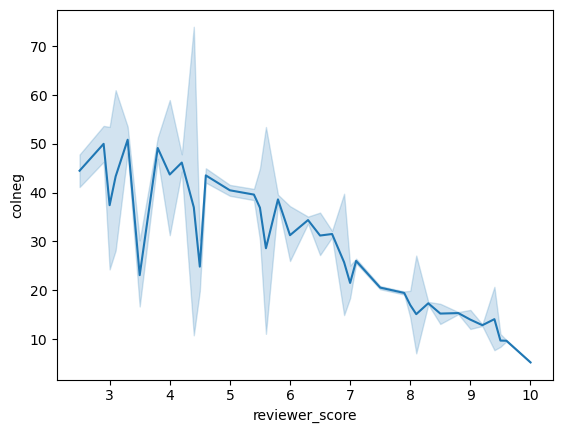

In [156]:
# посмотрим диаграммы распределения количества слов в отзывах
# let's look at the distribution charts of the number of words in reviews
sns.lineplot(
    x="reviewer_score", 
    y="colneg", 
    data=hotels[(hotels['colneg']>=0)])
plt.show()

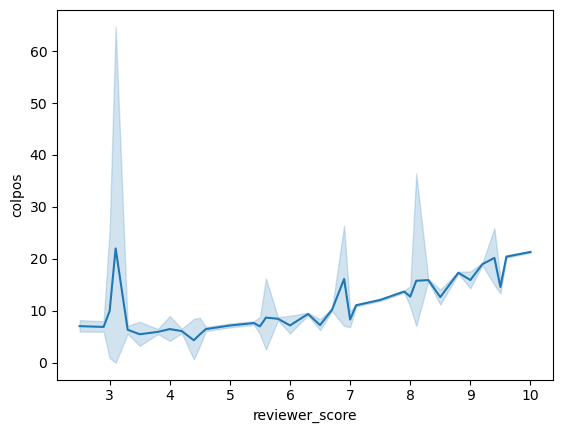

In [157]:
sns.lineplot(
    x="reviewer_score", 
    y="colpos", 
    data=hotels[(hotels['colpos']>=0)])
plt.show()

In [158]:
# построим гистограмму распределения количества слов в негативных отзывах и коробку с усами
# значения с количеством слов равное 0 исключим, как уже отработанные и неинформативные для наших следующих изысканий
# construct a histogram of the distribution of the number of words in negative reviews and a box plot
# exclude values with a word count of 0, as they are already exhausted and uninformative for our future research
fig = px.histogram(
    data_frame=hotels[hotels['colneg']>0],
    x='colneg',
    title='Distribution of word count in negative reviews',
    nbins=90,
    marginal='box',
    width=1000,
)
fig.show()

In [159]:
# построим гистограмму распределения количества слов в позитивных отзывах и коробку с усами
# значения с количеством слов равное 0 исключим, как уже отработанные и неинформативные для наших следующих изысканий
# construct a histogram of the distribution of the number of words in positive reviews and a box plot
# exclude values with a word count of 0, as they are already exhausted and uninformative for our future research
fig = px.histogram(
    data_frame=hotels[hotels['colpos']>0],
    x='colpos',
    title='Distribution of word count in positive reviews',
    nbins=90,
    marginal='box',
    width=1000,
)
fig.show()

Отсюда делаю вывод: оценка рецензента прямо пропорциональна количеству слов в позитивном отзыве и обратно пропорциональна количеству слов в негативном отзыве, и эта зависимость практически линейна. Для этих целей создам шаблон принудительной зависимости количества слов от оценки рецензента, по которому в дальнейшем будут определяться новые признаки:

В негативных отзывах:
 - количество слов 0 - оценка рецензента более или равная 9.5 (условная нулевая отметка),
 - количество слов 7 - оценка рецензента более или равная 9, но менее 9.5 (1-й квартиль),
 - количество слов 15 - оценка рецензента более или равная 7, но менее 9 (медиана),
 - количество слов 31 - оценка рецензента более или равная 6, но менее 7 (3-й квартиль),
 - количество слов 67 - оценка рецензента менее 6 (верхняя граница ящика с усами)

В позитивных отзывах:
 - количество слов 47 - оценка рецензента более или равная 9.5 (верхняя граница ящика с усами),
 - количество слов 22 - оценка рецензента более или равная 9, но менее 9.5 (3-й квартиль),
 - количество слов 11 - оценка рецензента более или равная 7, но менее 9 (медиана),
 - количество слов 5 - оценка рецензента более или равная 6, но менее 7 (1-й квартиль),
 - количество слов 0 - оценка рецензента менее 6 (условная нулевая отметка)
   
Понимая, что многие отзывы не имеют такой прямой зависимости, добавляю в новые признаки количества слов, полученную информацию из шаблонов.

From this, I conclude: the reviewer's rating is directly proportional to the number of words in a positive review and inversely proportional to the number of words in a negative review, and this relationship is practically linear. For these purposes, I will create a template for forcing the word count to depend on the reviewer's rating, which will subsequently be used to determine new features:

In negative reviews:
 - word count 0 - reviewer rating greater than or equal to 9.5 (conditional zero mark),
 - word count 7 - reviewer rating greater than or equal to 9 but less than 9.5 (1st quartile),
 - word count 15 - reviewer rating greater than or equal to 7 but less than 9 (median),
 - word count 31 - reviewer rating greater than or equal to 6 but less than 7 (3rd quartile),
 - word count 67 - reviewer rating less than 6 (upper bound of the box and whiskers)

In positive reviews:
 - word count 47 - reviewer rating greater than or equal to 9.5 (upper bound of the box and whiskers),
 - word count 22 - reviewer rating greater than or equal to 9 but less than 9.5 (3rd quartile),
 - 11 words - reviewer rating greater than or equal to 7 but less than 9 (median),
 - 5 words - reviewer rating greater than or equal to 6 but less than 7 (1st quartile),
 - 0 words - reviewer rating less than 6 (conditional zero mark)

Understanding that many reviews do not have such a direct correlation, I add the information obtained from the templates to the new word count features.

In [160]:
# сгруппируем все негативные отзывы и по ним определим медианное значение оценок рецензентов и их количество
# we will group all the negative reviews and determine the median value of the reviewers' ratings and their number
neg_rev = hotels.groupby(['negative_review']).agg({'reviewer_score': ['median', 'count']}). reset_index()

# с помощью ранее созданной функции, находим только повторяющиеся списки отзывов с необходимыми условиями
# using the previously created function, we find only duplicate lists of reviews with the required conditions
neg_lst_0 = phrases_median_count(neg_rev, 9.5, 10, 2)
neg_lst_7 = phrases_median_count(neg_rev, 9, 9.49, 2)
neg_lst_15 = phrases_median_count(neg_rev, 7, 8.99, 2)
neg_lst_31 = phrases_median_count(neg_rev, 6, 6.99, 2)
neg_lst_67 = phrases_median_count(neg_rev, 0, 5.99, 2)

# Функция, возвращающая количество слов,зависящее от медианных оценок отзывов
# A function that returns the word count based on the median review scores
def get_count_words_neg(neg_review):
    if neg_review in neg_lst_67:
        return 67
    if neg_review in neg_lst_31:
        return 31
    if neg_review in neg_lst_15:
        return 15
    if neg_review in neg_lst_7:
        return 7
    if neg_review in neg_lst_0:
        return 0
    return neg_review.count(' ') + 1

# перезапишем новые значения количества слов в созданный ранее признак 
# rewrite the new word count values into the previously created feature
hotels['colneg'] = hotels['negative_review'].apply(get_count_words_neg)

In [161]:
# сгруппируем все позитивные отзывы и по ним определим медианное значение оценок рецензентов и их количество
# we will group all the positive reviews and determine the median value of the reviewers' ratings and their number.
pos_rev = hotels.groupby(['positive_review']).agg({'reviewer_score': ['median', 'count']}). reset_index()

# с помощью ранее созданной функции, находим списки отзывов с необходимыми условиями
# using the previously created function, we find only duplicate lists of reviews with the required conditions
pos_lst_47 = phrases_median_count(pos_rev, 9.5, 10, 2)
pos_lst_22 = phrases_median_count(pos_rev, 9, 9.49, 2)
pos_lst_11 = phrases_median_count(pos_rev, 7, 8.99, 2)
pos_lst_5 = phrases_median_count(pos_rev, 6, 6.99, 2)
pos_lst_0 = phrases_median_count(pos_rev, 0, 5.99, 2)

# Функция, возвращающая количество слов,зависящее от медианных оценок отзывов
# A function that returns the word count based on the median review scores
def get_count_words_pos(pos_review):
    if pos_review in pos_lst_47:
        return 47
    if pos_review in pos_lst_22:
        return 22
    if pos_review in pos_lst_11:
        return 11
    if pos_review in pos_lst_5:
        return 5
    if pos_review in pos_lst_0:
        return 0
    return pos_review.count(' ') + 1

# перезапишем новые значения количества слов в созданный ранее признак 
# rewrite the new word count values into the previously created feature
hotels['colpos'] = hotels['positive_review'].apply(get_count_words_pos)

In [162]:
hotels.describe()

,additional_number_of_scoring,review_date,average_score,review_total_negative_word_counts,total_number_of_reviews,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,days_since_review,lat,...,tag_' Family with older children ',tag_' Deluxe Double Room ',tag_' Double or Twin Room ',num_tags,distance_to_center,hotel_name_encoded,lat_lng_sum,lat_lng_diff,colneg,colpos
count,386803.000000,386803,386803.000000,386803.000000,386803.000000,386803.000000,386803.00000,386803.000000,386803.000000,386803.000000,...,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000
mean,498.246536,2016-08-13 14:41:18.712936704,8.397231,17.353400,2743.992042,16.326799,7.17725,8.396906,354.387978,49.456537,...,0.051194,0.048146,0.043495,4.569566,10.177852,682.793125,52.262069,46.651006,17.888835,19.242423
min,1.000000,2015-08-04 00:00:00,5.200000,0.000000,43.000000,0.000000,1.00000,2.500000,0.000000,41.328376,...,0.000000,0.000000,0.000000,1.000000,0.035672,5.000000,43.441340,31.744897,0.000000,0.000000
25%,169.000000,2016-02-23 00:00:00,8.100000,1.000000,1161.000000,4.000000,1.00000,7.500000,175.000000,48.214662,...,0.000000,0.000000,0.000000,4.000000,1.391680,234.000000,51.274170,39.248795,0.000000,8.000000
50%,342.000000,2016-08-15 00:00:00,8.400000,7.000000,2134.000000,10.000000,3.00000,8.800000,353.000000,51.499981,...,0.000000,0.000000,0.000000,5.000000,2.498672,487.000000,51.369954,51.493897,9.000000,11.000000
75%,660.000000,2017-02-09 00:00:00,8.800000,22.000000,3613.000000,21.000000,8.00000,9.600000,527.000000,51.516288,...,0.000000,0.000000,0.000000,5.000000,4.144814,859.000000,54.623433,51.654826,22.000000,22.000000
max,2682.000000,2017-08-03 00:00:00,9.800000,406.000000,16670.000000,393.000000,355.00000,10.000000,730.000000,52.400181,...,1.000000,1.000000,1.000000,6.000000,1226.502543,3587.000000,64.668235,51.910152,406.000000,393.000000
std,500.258012,NaN,0.547881,29.344196,2316.457018,21.483410,11.05442,1.636090,208.975174,3.459794,...,0.220394,0.214075,0.203969,0.520163,90.949515,667.459082,4.814612,6.521503,29.374404,20.885959


In [163]:
# Попробуем узнать эмоциональную окраску отрицательных отзывов
# Let's try to find out the emotional coloring of negative reviews
sent_analyzer = SentimentIntensityAnalyzer()
hotels['negative_review_emo'] = hotels['negative_review'].apply(lambda string: sent_analyzer.polarity_scores(string))

# Создаем 4 новых признака по значениям словаря
# Create 4 new features based on dictionary values
hotels['neg'] = hotels['negative_review_emo'].apply(lambda x: x['neg'])
hotels['neu'] = hotels['negative_review_emo'].apply(lambda x: x['neu'])
hotels['pos'] = hotels['negative_review_emo'].apply(lambda x: x['pos'])
hotels['compound'] = hotels['negative_review_emo'].apply(lambda x: x['compound'])

hotels.drop(columns= 'negative_review_emo', inplace=True) # удаляю "отработанный" столбец # delete the "used" column

In [164]:
# Попробуем узнать эмоциональную окраску положительных отзывов
# Let's try to find out the emotional coloring of negative reviews
sent_analyzer = SentimentIntensityAnalyzer()
hotels['positive_review_emo'] = hotels['positive_review'].apply(lambda string: sent_analyzer.polarity_scores(string))

# Создаю 4 новых признака по значениям словаря
# # Create 4 new features based on dictionary values
hotels['neg_2'] = hotels['positive_review_emo'].apply(lambda x: x['neg'])
hotels['neu_2'] = hotels['positive_review_emo'].apply(lambda x: x['neu'])
hotels['pos_2'] = hotels['positive_review_emo'].apply(lambda x: x['pos'])
hotels['compound_2'] = hotels['positive_review_emo'].apply(lambda x: x['compound'])
hotels.drop(columns= 'positive_review_emo', inplace=True) # удаляю "отработанный" столбец # delete the "used" column

In [165]:
# создаем новый признак отношения положительных к отрицательным словам
# we create a new attribute of the relationship between positive and negative words
hotels['pos_neg_ratio'] = hotels['review_total_positive_word_counts'] / \
                          (hotels['review_total_negative_word_counts'] + 1)

In [166]:
# признак выходной (1) / будний (0)
# weekend (1) / weekday (0) indicator
hotels["is_weekend"] = hotels["review_date"].dt.weekday.isin([5, 6]).astype(int)

In [167]:
# лог-преобразования (сглаживают перекосы распределений)
# log transformations (smooth out skewed distributions)
hotels['log_total_reviews']              = np.log1p(hotels['total_number_of_reviews'])
hotels['log_reviews_by_reviewer']        = np.log1p(hotels['total_number_of_reviews_reviewer_has_given'])
hotels['log_pos_wc']                     = np.log1p(hotels['review_total_positive_word_counts'])
hotels['log_neg_wc']                     = np.log1p(hotels['review_total_negative_word_counts'])
hotels['log_distance']                   = np.log1p(hotels['distance_to_center'])
hotels['log_days_since_review']          = np.log1p(hotels['days_since_review'])

In [168]:
# интеракции и нормировки
# interactions and normalizations
# базовая «популярность» отеля: средний скор, взвешенный популярностью (не утечка)
# hotel base "popularity": average popularity-weighted score (not leaked)
hotels['avg_score_weighted']             = hotels['average_score'] * hotels['log_total_reviews']

# активность автора отзыва относительно популярности отеля
# the reviewer's activity regarding the hotel's popularity
hotels['reviewer_activity_ratio']        = hotels['total_number_of_reviews_reviewer_has_given'] / (hotels['total_number_of_reviews'] + 1)

# «центральность»: чем ближе к центру — тем больше
# "centrality": the closer to the center, the more
hotels['centrality']                     = 1.0 / (1.0 + hotels['distance_to_center'])

In [169]:
# релевантные флаги по времени
# relevant flags by time
hotels['recent_30d'] = (hotels['days_since_review'] <= 30).astype(int)
hotels['recent_90d'] = (hotels['days_since_review'] <= 90).astype(int)

In [170]:
# «свой/чужой» — совпадает ли страна отеля со страной рецензента 
# "friend/foe" - does the hotel's country match the reviewer's country?
def same_country(row):
    return int(str(row['hotel_country']).lower() in str(row['reviewer_nationality']).lower())

hotels['same_country'] = hotels.apply(same_country, axis=1).astype('int8')

In [171]:
# среднее отношение по отелю
# average hotel ratio
hotel_avg_pos_neg = hotels.groupby('hotel_name')['pos_neg_ratio'].transform('mean')
hotels['hotel_avg_pos_neg'] = hotel_avg_pos_neg

In [172]:
# среднее отношение по городу
# average ratio in the city
city_avg_pos_neg = hotels.groupby('hotel_city')['pos_neg_ratio'].transform('mean')
hotels['city_avg_pos_neg'] = city_avg_pos_neg

In [173]:
# скачивай из внешнего источника данные отелей со звездами
# download hotel star ratings from an external source
hotels_dataset = pd.read_csv('hotels_dataset.csv', encoding='latin1')
hotels_dataset.head()

,countyCode,countyName,cityCode,cityName,HotelCode,HotelName,HotelRating,Address,Attractions,Description,FaxNumber,HotelFacilities,Map,PhoneNumber,PinCode,HotelWebsiteUrl
0,AL,Albania,106078,Albanien,1003300,De Paris Hotel,FourStar,Nr. 7 Brigada Viii Street Tirane,NaN,Hotel de Paris is a charming boutique hotel th...,42268822,Private parking Parking onsite Television in c...,41.32213|19.81665,00355 4226 5009,1000,https://www.booking.com/hotel/al/de-paris.html
1,AL,Albania,106078,Albanien,1003301,Hotel Green,FourStar,Rruga Kavajes. Kombinat Km 2. Vaqarr VaqarrTir...,NaN,"Located in a suburb of Tirana, Hotel Green is ...",35548520058,airport pick up wifi available in all areas Ai...,41.30413|19.74703,+35548520057,1041,https://www.booking.com/hotel/al/hotel-green.html
2,AL,Albania,106078,Albanien,1003302,Theranda Hotel,ThreeStar,Rr. Andon Zako Cajupi Villa 6 & 7 Villa 6 & 7T...,NaN,"Set in Tirana, 1.2 km from Skanderbeg Square, ...",00355 (0)42273689,face masks for guests available all plates cu...,41.3216|19.81199,00355 (0)42273766,1019,https://www.booking.com/hotel/al/theranda.html
3,AL,Albania,106078,Albanien,1003303,Seven Hotel,ThreeStar,"KAVAJA STREET, CLOSE TURKISH AMBASSY TIRANA",Skanderbeg Square: within 500 metre,This hotel enjoys an enviable setting in Tiran...,NaN,À la carte dinner Breakfast buffet Breakfast C...,41.328027|19.815052,NaN,1001,http://www.hotelseven-tirana.com/
4,AL,Albania,106078,Albanien,1003325,Viktoria,ThreeStar,Rruga E Elbasanit Km 4 Sauk SaukTirana,NaN,Located in a new residential area at the edge ...,+355695406986,internet services Ironing service Family rooms...,41.29125|19.85349,355 69 5406986,1000,https://www.booking.com/hotel/al/viktoria-sauk...


In [174]:
print(hotels_dataset.columns)

Index(['countyCode', ' countyName', ' cityCode', ' cityName', ' HotelCode',
       ' HotelName', ' HotelRating', ' Address', ' Attractions',
       ' Description', ' FaxNumber', ' HotelFacilities', ' Map',
       ' PhoneNumber', ' PinCode', ' HotelWebsiteUrl'],
      dtype='object')


In [175]:
# приводим названия к нижнему регистру и убираем лишние пробелы
# convert the names to lowercase and remove extra spaces
hotels['hotel_name_clean'] = hotels['hotel_name'].str.lower().str.strip()
hotels_dataset['hotel_name_clean'] = hotels_dataset[' HotelName'].str.lower().str.strip()

In [176]:
# оставляем только нужные столбцы из внешнего датасета
# leave only the necessary columns from the external dataset
external = hotels_dataset[['hotel_name_clean', ' HotelRating']]

In [177]:
# удаляем дубликаты
# remove duplicates
external_unique = external.drop_duplicates(subset='hotel_name_clean')

In [178]:
external_unique.info()

<class 'pandas.core.frame.DataFrame'>
Index: 717006 entries, 0 to 1010032
Data columns (total 2 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   hotel_name_clean  717006 non-null  object
 1    HotelRating      717006 non-null  object
dtypes: object(2)
memory usage: 16.4+ MB


In [179]:
# объединяем с нашим DataFrame
# merge with our DataFrame
hotels = pd.merge(hotels, external_unique[['hotel_name_clean', ' HotelRating']], 
                  on='hotel_name_clean', how='left')

# проверим результат
# check the result
print(hotels[['hotel_name', ' HotelRating']].head(20))

                                   hotel_name  HotelRating
0                          The May Fair Hotel          NaN
1             Mercure London Bloomsbury Hotel          NaN
2           Legend Saint Germain by Elegancia          NaN
3   Mercure Paris 19 Philharmonie La Villette          NaN
4                 Golden Tulip Amsterdam West          NaN
5             Novotel Milano Linate Aeroporto     FourStar
6         Holiday Inn London Kensington Forum     FourStar
7                      Mercure Josefshof Wien          NaN
8        The Gore Hotel Starhotels Collezione     FourStar
9              Hilton London Kensington Hotel     FourStar
10                Golden Tulip Amsterdam West          NaN
11             Hotel Indigo London Kensington     FourStar
12                             Number Sixteen     FiveStar
13        Holiday Inn London Kensington Forum     FourStar
14                      Catalonia Park Putxet     FourStar
15                           Ayre Hotel Caspe    ThreeSt

In [180]:
# преобразуем текстовые категории в числа
# convert text categories into numbers
rating_map = {
    'OneStar': 1,
    'TwoStar': 2,
    'ThreeStar': 3,
    'FourStar': 4,
    'FiveStar': 5
}

hotels['stars'] = hotels[' HotelRating'].map(rating_map)

In [181]:
# создаём бинарный признак, указывающий на отсутствие информации
# create a binary feature indicating the absence of information
hotels['stars_unknown'] = hotels['stars'].isna().astype(int)

In [182]:
# заполняем пропуски медианой по городу
# fill in the blanks with the city median
hotels['stars'] = hotels.groupby('hotel_city')['stars'].transform(lambda x: x.fillna(x.median()))

In [183]:
hotels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 92 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   hotel_address                               386803 non-null  object        
 1   additional_number_of_scoring                386803 non-null  int64         
 2   review_date                                 386803 non-null  datetime64[ns]
 3   average_score                               386803 non-null  float64       
 4   hotel_name                                  386803 non-null  object        
 5   reviewer_nationality                        386803 non-null  object        
 6   negative_review                             386803 non-null  object        
 7   review_total_negative_word_counts           386803 non-null  int64         
 8   total_number_of_reviews                     386803 non-null  int64        

In [184]:
# создаем дубликат нашего DataFrame
# create a duplicate of our DataFrame
hotels2 = hotels.copy()

In [185]:
# убираем исходные текстовые колонки
# remove the original text columns
object_columns = [s for s in hotels2.columns if hotels2[s].dtypes == 'object']
hotels2.drop(object_columns, axis = 1, inplace=True)

In [186]:
hotels2 = hotels2.drop(['review_date'], axis=1)

In [187]:
hotels2.shape

(386803, 81)

In [188]:
hotels2.head()

,additional_number_of_scoring,average_score,review_total_negative_word_counts,total_number_of_reviews,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,days_since_review,lat,lng,...,avg_score_weighted,reviewer_activity_ratio,centrality,recent_30d,recent_90d,same_country,hotel_avg_pos_neg,city_avg_pos_neg,stars,stars_unknown
0,581,8.4,1,1994,3,7,10.0,531,51.507894,-0.143671,...,63.826554,0.003509,0.476243,0,0,1,5.510765,5.195360,4.0,1
1,299,8.3,2,1361,1,14,6.3,203,51.521009,-0.123097,...,59.898689,0.010279,0.392495,0,0,1,5.256815,5.195360,4.0,1
2,32,8.9,4,406,0,14,7.5,289,48.845377,2.325643,...,53.478437,0.034398,0.302174,0,0,0,11.278871,6.758794,4.0,1
3,34,7.5,0,607,9,8,10.0,681,48.888697,2.394540,...,48.076312,0.013158,0.174668,0,0,0,6.196037,6.758794,4.0,1
4,914,8.5,2,7586,18,10,9.6,516,52.385601,4.847060,...,75.940628,0.001318,0.186611,0,0,0,5.920609,6.298262,4.0,1


In [189]:
# выбираем только числовые признаки
# select only numerical features
num_cols = hotels2.select_dtypes(include=np.number).columns

# считаем корреляционную матрицу
# calculate the correlation matrix
corr_matrix = hotels2[num_cols].corr().abs()

# создаем маску для верхнего треугольника (чтобы не дублировать пары)
# create a mask for the top triangle (to avoid duplicating pairs)
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# ищем признаки с высокой корреляцией
# looking for features with high correlation
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]

print(f"Признаки, которые можно удалить из-за сильной корреляции: {len(to_drop)}")
print(f"Features that can be removed due to strong correlation: {len(to_drop)}")
print(to_drop)

Признаки, которые можно удалить из-за сильной корреляции: 9
Features that can be removed due to strong correlation: 9
['country_freq', 'review_year', 'review_quarter', 'num_tags', 'hotel_name_encoded', 'colneg', 'colpos', 'pos', 'city_avg_pos_neg']


In [190]:
# убираем колонки с сильной корреляцией
# remove columns with strong correlation
hotels2 = hotels2.drop(to_drop, axis=1)

In [191]:
hotels2.shape

(386803, 72)

In [192]:
hotels2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 72 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   additional_number_of_scoring                386803 non-null  int64  
 1   average_score                               386803 non-null  float64
 2   review_total_negative_word_counts           386803 non-null  int64  
 3   total_number_of_reviews                     386803 non-null  int64  
 4   review_total_positive_word_counts           386803 non-null  int64  
 5   total_number_of_reviews_reviewer_has_given  386803 non-null  int64  
 6   reviewer_score                              386803 non-null  float64
 7   days_since_review                           386803 non-null  int64  
 8   lat                                         386803 non-null  float64
 9   lng                                         386803 non-null  float64
 

### 4. Создание модели предсказания. Creating a prediction model

In [193]:
# Разбиваем датафрейм на части, необходимые для обучения и тестирования модели
# split the dataframe into parts necessary for training and testing the model
# Х - данные с информацией об отелях, у - целевая переменная (рейтинги отелей)  
# X - is the data with information about hotels, y - is the target variable (hotel ratings)
X = hotels2.drop(['reviewer_score'], axis = 1)  
y = hotels2['reviewer_score'] 

In [194]:
# Загружаем специальный инструмент для разбивки 
# Loading a special tool for breaking down
from sklearn.model_selection import train_test_split  

In [195]:
# Наборы данных с меткой "train" будут использоваться для обучения модели, "test" - для тестирования
# Datasets labeled "train" will be used to train the model, "test" - for testing
# Для тестирования мы будем использовать 25% от исходного датасета
# For testing, we will use 25% of the original dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [196]:
# Импортируем необходимые библиотеки
# Importing the necessary libraries
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.ensemble import RandomForestRegressor # инструмент для создания и обучения модели  # a tool for creating and training a model
from sklearn import metrics # инструменты для оценки точности модели # tools for assessing model accuracy 

In [197]:
# С помощью выбора k лучших переменных выбираем 20 самых важных признаков
# И так какк у нас целевой признак численный, то будет использовать f_regression
# Using the k-best variable selection, we select the 20 most important features
# And since our target feature is numerical, f_regression will be used
selector = SelectKBest(f_regression, k=20)
selector.fit(X_train, y_train)
 
selector.get_feature_names_out()

array(['average_score', 'review_total_negative_word_counts',
       'review_total_positive_word_counts', "tag_[' Leisure trip '",
       "tag_' Solo traveler '", "tag_[' Business trip '", 'neg', 'neu',
       'compound', 'neg_2', 'pos_2', 'compound_2', 'pos_neg_ratio',
       'log_total_reviews', 'log_pos_wc', 'log_neg_wc',
       'avg_score_weighted', 'centrality', 'hotel_avg_pos_neg', 'stars'],
      dtype=object)

In [198]:
# Создаем матрицу наблюдений X и вектор ответов y с самыми важными признаками
# We create a matrix of observations X and a vector of responses y with the most important features
X2 = hotels2[['average_score', 'review_total_negative_word_counts',
       'review_total_positive_word_counts', "tag_[' Leisure trip '",
       "tag_' Solo traveler '", "tag_[' Business trip '", 'neg', 'neu',
       'compound', 'neg_2', 'pos_2', 'compound_2', 'pos_neg_ratio',
       'log_total_reviews', 'log_pos_wc', 'log_neg_wc',
       'avg_score_weighted', 'centrality', 'hotel_avg_pos_neg', 'stars']] 
y2 = hotels2['reviewer_score'] 

In [199]:
# Разделяем выборку на тренировочную и тестовую в соотношении 75/25
# We divide the sample into training and testing in a ratio of 75/25
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size=0.25, random_state=42)

In [200]:
# Создаём модель 
# Creating a model
regr = RandomForestRegressor(n_estimators=100)  
      
# Обучаем модель на тренировочном наборе данных
# We train the model on the train dataset
regr.fit(X_train2, y_train2)  
      
# Используем обученную модель для предсказания рейтинга отелей в тестовой выборке
# We use the trained model to predict hotel ratings in the test sample
# Предсказанные значения записываем в переменную y_pred
# The predicted values are written into the variable y_pred
y_pred = regr.predict(X_test2)  

In [201]:
# Сравниваем предсказанные значения (y_pred) с реальными (y_test), и смотрим насколько они отличаются 
# We compare the predicted values (y_pred) with the actual ones (y_test) and see how much they differ
# Метрика называется Mean Absolute Percentage Error (MAPE) и показывает среднюю абсолютную процентную ошибку предсказанных значений от фактических
# The metric is called Mean Absolute Percentage Error (MAPE) and shows the average absolute percentage error of predicted values from actual ones
print('MAPE:', metrics.mean_absolute_percentage_error(y_test2, y_pred))

MAPE: 0.12126124029805352


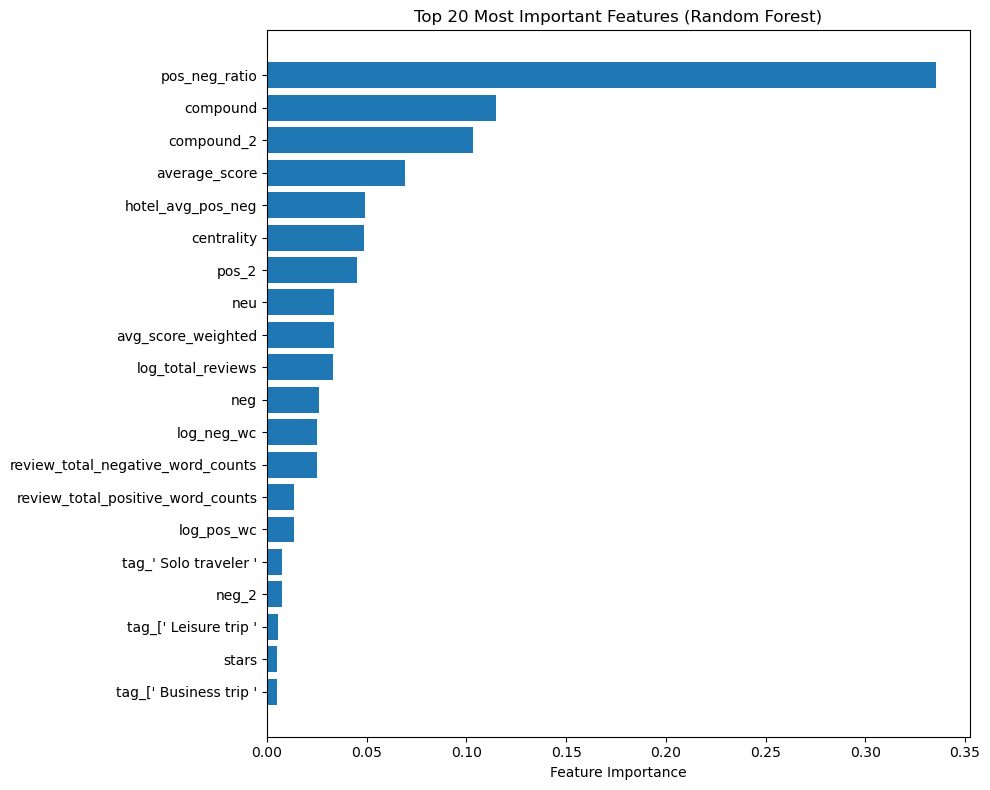

In [202]:
# В RandomForestRegressor есть возможность вывести самые важные признаки для модели
# RandomForestRegressor has the ability to extract the most important features for a model
importances = regr.feature_importances_
features = X2.columns

# Создаем DataFrame, где каждая строка показывает:
# признак → и насколько он важен для финального предсказания модели
# Create a DataFrame where each row shows:
# a feature → and how important it is for the model's final prediction
rf_importance_df = pd.DataFrame({
    'feature': features,
    'importance': importances
}).sort_values(by='importance', ascending=False)


# Визуализируем 
# Visualize
plt.figure(figsize=(10, 8))
plt.barh(rf_importance_df['feature'], rf_importance_df['importance'])
plt.gca().invert_yaxis()
plt.xlabel('Feature Importance')
plt.title('Top 20 Most Important Features (Random Forest)')
plt.tight_layout()
plt.show()

### 5. Итоговый вывод по проекту. Final Project Summary

В рамках проекта были использованы данные по отелям, включающие 17 исходных признаков. На этапе предобработки была проведена комплексная очистка данных: обработаны пропуски, корректно обработаны признаки с датами, текстовые поля и создано множество новых производных признаков. Особое внимание было уделено анализу отзывов гостей, так как текстовые характеристики и их количественные метрики оказывают значимое влияние на итоговую оценку отеля.

После формирования финального набора данных была построена матрица корреляции, на основании которой удалены нерелевантные и сильно коррелирующие признаки. Далее с использованием метода выбора k лучших переменных были отобраны 20 наиболее значимых признаков, которые были использованы для обучения модели RandomForestRegressor.

Построенная модель показала качество предсказания с метрикой
MAPE = 0.1212,
что соответствует достаточно высокой точности при оценке рейтинга отелей.

Дополнительно была визуализирована важность признаков в модели. Согласно графику, наибольшее влияние на итоговое предсказание оказывают признаки, связанные с характеристиками отзывов — их содержание, количество положительных и отрицательных слов, а также дополнительные атрибуты взаимодействия пользователей с отелем. Это подтверждает ключевую роль пользовательских отзывов в формировании итогового рейтинга отелей.


In this project, hotel data containing 17 initial features was analyzed. A comprehensive data preprocessing workflow was performed, including handling missing values, processing date-related and text features, and creating multiple new engineered features. Special attention was given to guest reviews, as both their content and structure have a strong impact on the final hotel rating.

After forming the final dataset, a correlation matrix was constructed, which allowed for the removal of irrelevant and highly correlated features. Using the SelectKBest method, the top 20 most important features were identified and used to train the RandomForestRegressor model.

The trained model demonstrated solid predictive performance with a
MAPE = 0.1212,
which indicates a high level of accuracy in predicting hotel ratings.

Feature importance was also visualized, showing that the strongest influence on the model’s predictions comes from review-related features — the content of reviews, counts of positive and negative words, and additional user interaction attributes. This confirms the crucial role of customer feedback in determining the overall hotel rating.

### Улучшения качества предстказания с помощью более сильного алгоритма. Improving the quality of prediction with a stronger algorithm

Попробуем улучшить значение метрики, используя CatBoost.
CatBoost — один из лучших вариантов для табличных данных с текстами, категориальными признаками и большим количеством фичей. 
Он часто даёт более низкий MAPE, чем RandomForest.

Let's try improving this metric using CatBoost.
CatBoost is one of the best options for tabular data with text, categorical features, and a large number of features.
It often yields a lower MAPE than RandomForest.

In [96]:
# создаем дубликат нашего DataFrame
# create a duplicate of our DataFrame
hotels3 = hotels.copy()

In [97]:
hotels3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 92 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   hotel_address                               386803 non-null  object        
 1   additional_number_of_scoring                386803 non-null  int64         
 2   review_date                                 386803 non-null  datetime64[ns]
 3   average_score                               386803 non-null  float64       
 4   hotel_name                                  386803 non-null  object        
 5   reviewer_nationality                        386803 non-null  object        
 6   negative_review                             386803 non-null  object        
 7   review_total_negative_word_counts           386803 non-null  int64         
 8   total_number_of_reviews                     386803 non-null  int64        

In [98]:
from catboost import CatBoostRegressor

In [99]:
hotels3 = hotels3.drop(['review_date'], axis=1)

In [100]:
# выбираем только числовые признаки
# select only numerical features
num_cols = hotels3.select_dtypes(include=np.number).columns

# считаем корреляционную матрицу
# calculate the correlation matrix
corr_matrix = hotels3[num_cols].corr().abs()

# создаем маску для верхнего треугольника (чтобы не дублировать пары)
# create a mask for the top triangle (to avoid duplicating pairs)
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# ищем признаки с высокой корреляцией
# looking for features with high correlation
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]

print(f"Признаки, которые можно удалить из-за сильной корреляции: {len(to_drop)}")
print(f"Features that can be removed due to strong correlation: {len(to_drop)}")
print(to_drop)

Признаки, которые можно удалить из-за сильной корреляции: 9
Features that can be removed due to strong correlation: 9
['country_freq', 'review_year', 'review_quarter', 'num_tags', 'hotel_name_encoded', 'colneg', 'colpos', 'pos', 'city_avg_pos_neg']


In [101]:
# убираем колонки с сильной корреляцией
# remove columns with strong correlation
hotels3 = hotels3.drop(to_drop, axis=1)

In [102]:
hotels3.shape

(386803, 82)

In [103]:
# Выделяем текстовые признаки
# Highlight text features
text_features = ['positive_review', 'negative_review']

# Берем только числовые признаки
# We take only numerical features
X_numeric = hotels3.select_dtypes(include=['int64', 'float64']).copy()

# Объединяем числовые и текстовые колонки для модели
# Combine numeric and text columns for the model
X_model = pd.concat([X_numeric, hotels3[text_features]], axis=1)

In [104]:
# Разбиваем датафрейм на части, необходимые для обучения и тестирования модели
# split the dataframe into parts necessary for training and testing the model
X = X_model.drop(['reviewer_score'], axis = 1)   
y = hotels3['reviewer_score'] 

In [105]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.25, random_state=42
)

In [107]:
# Создаём модель 
# Creating a model
model = CatBoostRegressor(
    iterations=1500,
    learning_rate=0.03,
    depth=8,
    loss_function='MAPE',
    random_seed=42,
    verbose=200
)

# Обучаем модель на тренировочном наборе данных
# We train the model on the train dataset
model.fit(
    X_train, y_train,
    text_features=text_features,
    eval_set=(X_test, y_test)
)

# Используем обученную модель для предсказания рейтинга отелей в тестовой выборке
# We use the trained model to predict hotel ratings in the test sample
y_pred = model.predict(X_test)

# Выводим значение метрики
# Display the metric value
print("MAPE:", metrics.mean_absolute_percentage_error(y_test, y_pred))

0:	learn: 0.1923566	test: 0.1923789	best: 0.1923789 (0)	total: 802ms	remaining: 20m 1s
200:	learn: 0.1172174	test: 0.1176299	best: 0.1176299 (200)	total: 3m 14s	remaining: 20m 56s
400:	learn: 0.1135559	test: 0.1143852	best: 0.1143852 (400)	total: 6m 9s	remaining: 16m 53s
600:	learn: 0.1109595	test: 0.1122354	best: 0.1122354 (600)	total: 9m 29s	remaining: 14m 12s
800:	learn: 0.1092954	test: 0.1110326	best: 0.1110326 (800)	total: 12m 26s	remaining: 10m 51s
1000:	learn: 0.1080772	test: 0.1102241	best: 0.1102241 (1000)	total: 15m 33s	remaining: 7m 45s
1200:	learn: 0.1070687	test: 0.1096265	best: 0.1096265 (1200)	total: 18m 41s	remaining: 4m 39s
1400:	learn: 0.1062001	test: 0.1091385	best: 0.1091385 (1400)	total: 21m 52s	remaining: 1m 32s
1499:	learn: 0.1058112	test: 0.1089223	best: 0.1089223 (1499)	total: 23m 22s	remaining: 0us

bestTest = 0.1089223183
bestIteration = 1499

MAPE: 0.10892231874304377


Нам удалось улучшить значение метрик MAPE: 0.1089. Можно продолжить, подбирая гиперпараметры, пробуя другие алгоритмы, но пока остановимся. Данный результат достаточно хорош конечного решения.

We managed to improve the MAPE metric value to 0.1089. We can continue by adjusting hyperparameters and trying other algorithms, but let's stop here for now. This result is quite good for the final solution.